# Aggregate data sources to France Hexagons

In [1]:
import warnings

warnings.filterwarnings("ignore")

In [2]:
import urbanpy as up
import pandas as pd
import geopandas as gpd
import plotly
import plotly.express as px
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
from tqdm.notebook import tqdm

In [3]:
tqdm.pandas()

## Downloading data for different cities and plotting

In [4]:
gadm_france = gpd.read_file("data_pre_process/gadm41_FRA_0.json")

<Axes: >

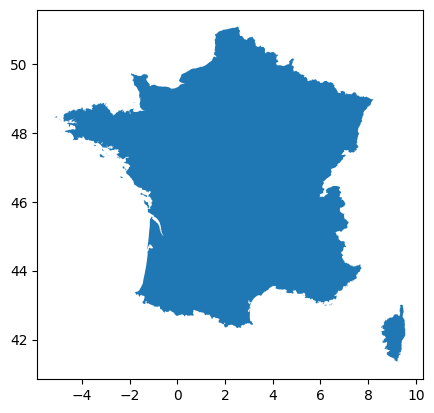

In [5]:
gadm_france.plot()

In [6]:
# arg_resources_df = up.download.search_hdx_dataset("argentina")
# arg_resources_df

Let's download the dataset with overall population density, which have the id of **1**

In [7]:
# pop_arg = up.download.get_hdx_dataset(arg_resources_df, 1)

In [8]:
# pop_arg.head()

### Conversion to Point geometries and hexagons

We got the lat lon coordinates but their are just in numerical format, we need them as geometries to perform spatial operations on the hexagon grid

First, lets filter the national population to our city bounds

In [9]:
# pop_ba = up.geom.filter_population(pop_arg, ba)

Applying filter_population gives us the set of points within our city's bounds and a Point geometry to work with hexagons

### Removing unnecesary features

In [10]:
# ax = pop_lima.plot()
# pop_lima.cx[-77.3:-77.17, -12.2:-12].plot(color="r", ax=ax)

We don't need the San Lorenzo island. By providing a bounding box we can remove it

In [11]:
# pop_lima = up.geom.remove_features(pop_lima, [-77.3, -12.2, -77.17, -12])

Let's generate the hexagon grid using Uber's H3

In [12]:
hex_fra_hex7 = up.geom.gen_hexagons(resolution=7, city=gadm_france)
hex_fra_hex7.shape

(113448, 2)

In [ ]:
if False:
    hex_fra_hex7.explore()

Notice the effect of the resolution parameter (higher resolution values generate smaller hexagons)

### Merging the grid layer

We will read the grid connection layer and count the number of high voltage grid connections substations points per hexagon.

In [15]:
grid_df = pd.read_csv("data_pre_process/grid_pre_process.csv", delimiter=";")

In [16]:
grid_lat_lon = (
    grid_df["Geo Point"]
    .str.split(",", expand=True)
    .rename(columns={0: "lat", 1: "lon"})
    .astype({"lon": "float", "lat": "float"})
)
grid_df = gpd.GeoDataFrame(
    grid_df,
    geometry=gpd.points_from_xy(grid_lat_lon["lon"], grid_lat_lon["lat"]),
    crs="EPSG:4326",
)

In [37]:
grid_df.explore()

In [17]:
grid_df = grid_df.reset_index()

In [18]:
assert (
    grid_df.shape[0] == grid_df["index"].nunique()
), "There are duplicate indices in the grid DataFrame."

In [19]:
hex_france_with_grid = up.geom.merge_shape_hex(
    hex_fra_hex7, grid_df, agg={"index": "count"}
).rename(columns={"index": "nb_grid_connections"})

<Axes: >

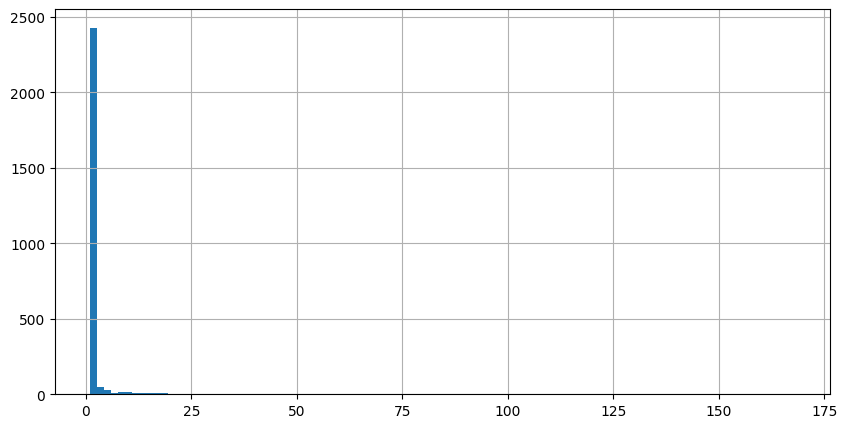

In [20]:
hex_france_with_grid["nb_grid_connections"].hist(bins=100, figsize=(10, 5))

In [21]:
print(
    f"Number of grid connections: {hex_france_with_grid['nb_grid_connections'].sum()}"
)
print(
    f"Percentage of missing grid connections: {hex_france_with_grid['nb_grid_connections'].isna().sum() / hex_france_with_grid.shape[0] * 100:.2f}%"
)

Number of grid connections: 5002.0
Percentage of missing grid connections: 97.70%


In [ ]:
# hex_france_with_grid.explore(
#     column="nb_grid_connections",
#     cmap="viridis",
#     legend=True,
#     tooltip=True,
#     name="Number of grid connections",
#     style_kwds={"weight": 0.5, "color": "black", "fillOpacity": 0.7},
#     fitbounds=True,
# )

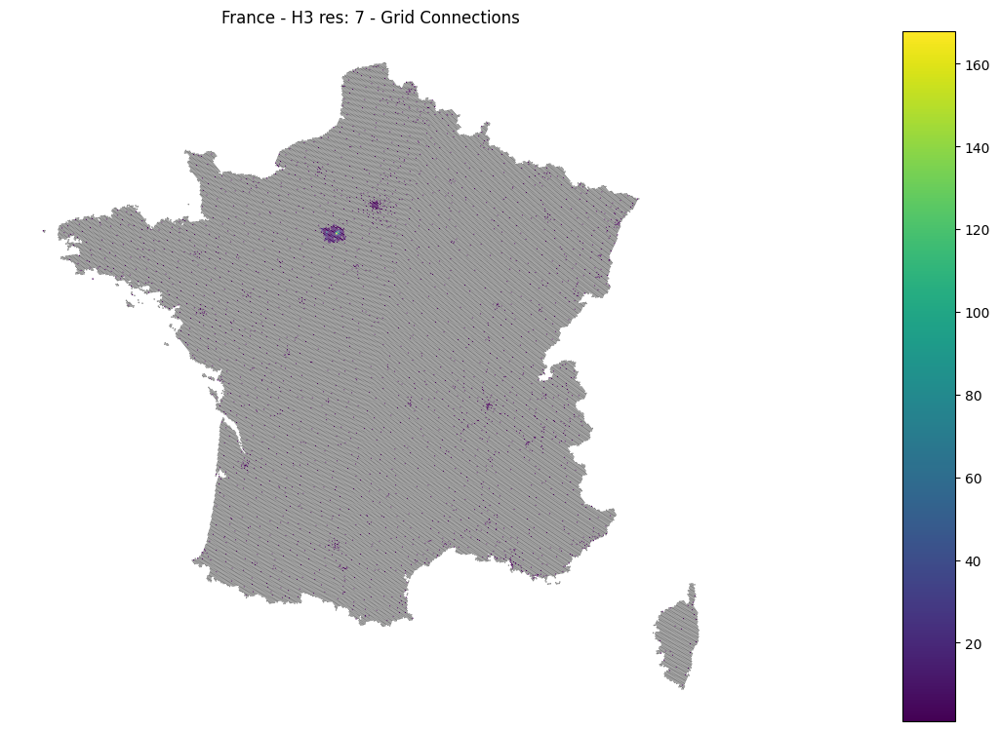

In [22]:
fig, ax1 = plt.subplots(1, 1, figsize=(12, 12))

divider1 = make_axes_locatable(ax1)
cax1 = divider1.append_axes("right", size="5%", pad=0.1)

hex_france_with_grid.plot(
    "nb_grid_connections", legend=True, missing_kwds={"color": "grey"}, ax=ax1, cax=cax1
)
ax1.set_title("France - H3 res: 7 - Grid Connections")
ax1.set_axis_off()

plt.tight_layout()

We've used an inner join to keep only the points that intersect a hexagon (in this case, a within operation gives similar results). We provide a dictionary detailing how to aggregate our fields of interest

In [30]:
m = hex_france_with_grid[hex_france_with_grid["nb_grid_connections"] > 150].explore()
m

NOTE: We have found a abberrant value in the number of grid connections (>150), so we will cap it to 50.

In [ ]:
hex_france_with_grid["nb_grid_connections"] = hex_france_with_grid[
    "nb_grid_connections"
].clip(upper=50)

In [32]:
def min_max_scale(series, min=0, max=1):
    """Normalize a pandas Series to the range [min, max]."""
    return (series - series.min()) / (series.max() - series.min()) * (max - min) + min

In [33]:
hex_france_with_grid["nb_grid_connections_norm"] = min_max_scale(
    hex_france_with_grid["nb_grid_connections"]
)

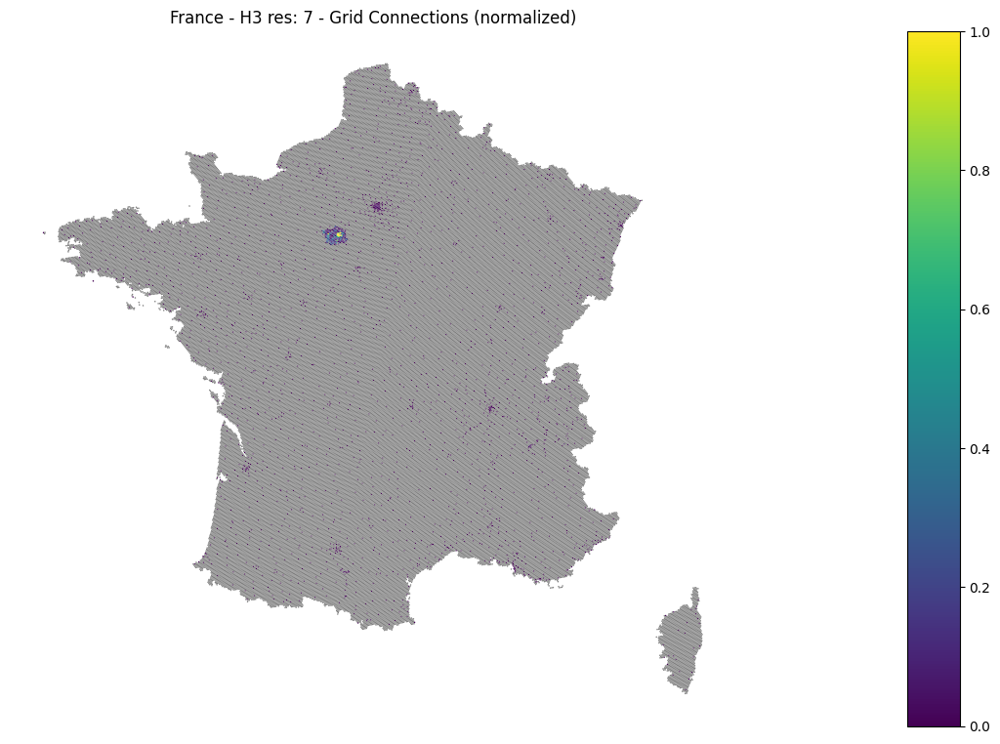

In [ ]:
fig, ax1 = plt.subplots(1, 1, figsize=(12, 12))

divider1 = make_axes_locatable(ax1)
cax1 = divider1.append_axes("right", size="5%", pad=0.1)

hex_france_with_grid.plot(
    "nb_grid_connections_norm",
    legend=True,
    missing_kwds={"color": "grey"},
    ax=ax1,
    cax=cax1,
)
ax1.set_title("France - H3 res: 7 - Grid Connections (normalized)")
ax1.set_axis_off()

plt.tight_layout()

In [ ]:
### SAVE DATA TO START CONNECTING

In [97]:
hex_france_with_grid.head()

,hex,geometry,nb_grid_connections,nb_grid_connections_norm
0,871eb0a14ffffff,"POLYGON ((9.45349 42.9889, 9.45484 42.97618, 9...",NaN,NaN
1,871eb2211ffffff,"POLYGON ((9.01 41.57103, 9.01139 41.55817, 9.0...",NaN,NaN
2,871eb0693ffffff,"POLYGON ((9.14919 42.10934, 9.15057 42.09653, ...",NaN,NaN
3,871eb2398ffffff,"POLYGON ((8.84767 41.53586, 8.84908 41.52301, ...",NaN,NaN
4,871eb07b6ffffff,"POLYGON ((8.96041 42.30443, 8.96181 42.29166, ...",NaN,NaN


In [165]:
(
    hex_france_with_grid.rename(
        columns={
            "hex": "hexagon_id",
            "nb_grid_connections": "connection_points",
            "nb_grid_connections_norm": "normalized_score",
        }
    )
    .drop(columns=["geometry"])
    .to_csv("data_processed/hex_france_with_grid.csv", index=False)
)

In [ ]:
### END SAVE DATA

### Merging the temperature layer

Temperature layer is based on the departments
We have to assing a location to every temperature value. We also have to process the timestamps and aggregate to the hex by year.

In [ ]:
temp_df = pd.read_csv(
    "data_pre_process/temp_pre_process/temp_pre_process.csv", delimiter=";"
)

In [37]:
temp_df

,Date,Code INSEE département,Département,TMin (°C),TMax (°C),TMoy (°C)
0,2025-03-01,04,Alpes-de-Haute-Provence,3.50,13.50,8.50
1,2025-03-01,46,Lot,-2.20,10.40,4.10
2,2025-03-01,65,Hautes-Pyrénées,2.70,10.50,6.60
3,2025-03-01,27,Eure,-1.10,7.30,3.10
4,2025-03-02,39,Jura,1.50,10.60,6.05
...,...,...,...,...,...,...
262843,2018-04-14,11,Aude,11.75,14.35,13.05
262844,2018-04-14,62,Pas-de-Calais,5.05,15.40,10.23
262845,2018-04-14,36,Indre,9.50,17.40,13.45
262846,2018-04-14,63,Puy-de-Dôme,8.30,15.10,11.70


## load departments data

In [ ]:
departments_gdf = gpd.read_file(
    "data_pre_process/temp_pre_process/departments-simplified-by-geoapi.geojson"
)

<Axes: >

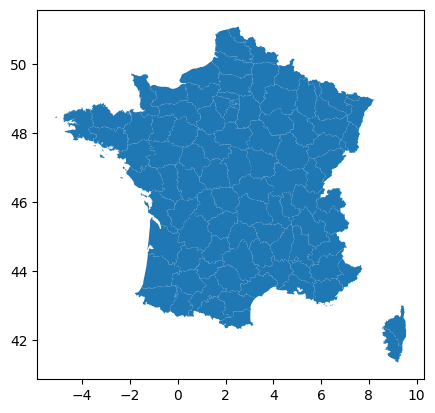

In [71]:
departments_gdf.plot()

In [155]:
# departments_gdf, avg_temp

In [156]:
departments_gdf = departments_gdf.dropna(subset=["fields_nom_dep"])

In [157]:
departments_gdf["clean_names"] = departments_gdf["fields_nom_dep"].str.lower().unique()

In [158]:
departments_gdf["fields_nom_dep"].str.lower().nunique()  # Unique department names

96

In [160]:
pd.Series(temp_df["Département"].str.lower().unique()).isin(
    departments_gdf["fields_nom_dep"].str.lower().unique()
).all()

np.True_

In [162]:
temp_df["clean_names"] = temp_df["Département"].str.lower()

In [ ]:
avg_temp_by_dept = temp_df.groupby("clean_names").agg(
    {
        "TMoy (°C)": "mean",
    }
)
avg_temp_by_dept

,TMoy (°C)
clean_names,
ain,12.884898
aisne,11.667093
allier,12.689134
alpes-de-haute-provence,14.209423
alpes-maritimes,16.889898
...,...
vendée,13.656907
vienne,13.215267
vosges,12.051322


In [166]:
departments_gdf.columns

Index(['fields', 'fields_nom_dep', 'fields_geom', 'geo_point_2d', 'geometry',
       'clean_names'],
      dtype='object')

In [168]:
avg_temp_by_dept

,TMoy (°C)
clean_names,
ain,12.884898
aisne,11.667093
allier,12.689134
alpes-de-haute-provence,14.209423
alpes-maritimes,16.889898
...,...
vendée,13.656907
vienne,13.215267
vosges,12.051322


In [ ]:
avg_temp_by_dept.columns

Index(['TMoy (°C)'], dtype='object')

In [ ]:
departments_with_temp = departments_gdf.merge(
    avg_temp_by_dept, left_on="clean_names", right_index=True, how="left"
)

<Axes: >

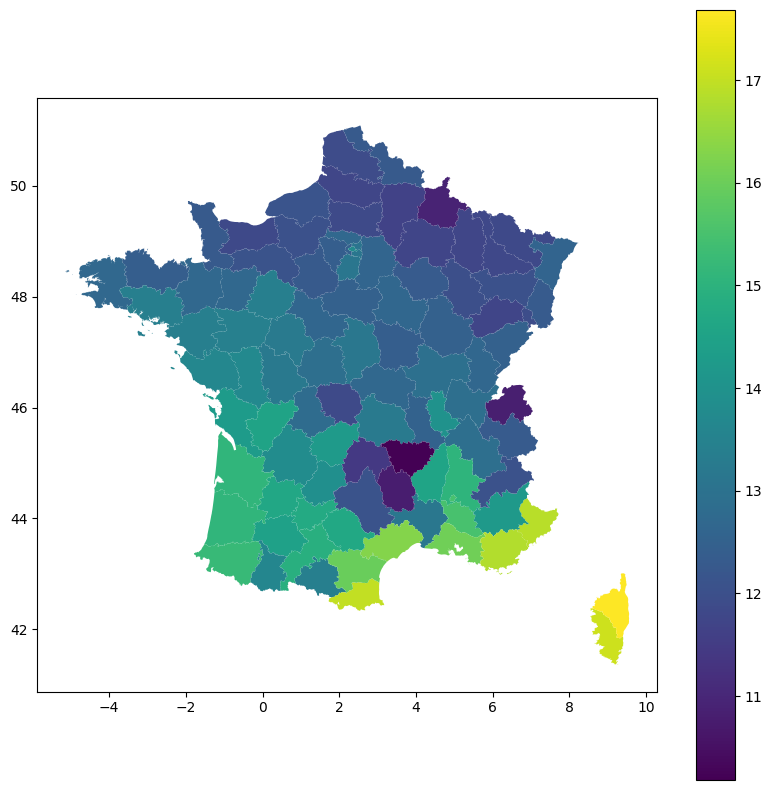

In [170]:
departments_with_temp.plot("TMoy (°C)", legend=True, figsize=(10, 10))

In [ ]:
hex_france_with_grid_temp = hex_france_with_grid.sjoin(
    departments_with_temp[["TMoy (°C)", "clean_names", "geometry"]],
    how="left",
    predicate="intersects",
    lsuffix="_hex",
    rsuffix="_dept",
).drop_duplicates(subset=["hex"])

In [192]:
hex_france_with_grid_temp.head()

,hex,geometry,nb_grid_connections,nb_grid_connections_norm,index__dept,TMoy (°C),clean_names
0,871eb0a14ffffff,"POLYGON ((9.45349 42.9889, 9.45484 42.97618, 9...",NaN,NaN,70.0,17.683302,haute-corse
1,871eb2211ffffff,"POLYGON ((9.01 41.57103, 9.01139 41.55817, 9.0...",NaN,NaN,36.0,17.125909,corse-du-sud
2,871eb0693ffffff,"POLYGON ((9.14919 42.10934, 9.15057 42.09653, ...",NaN,NaN,70.0,17.683302,haute-corse
3,871eb2398ffffff,"POLYGON ((8.84767 41.53586, 8.84908 41.52301, ...",NaN,NaN,36.0,17.125909,corse-du-sud
4,871eb07b6ffffff,"POLYGON ((8.96041 42.30443, 8.96181 42.29166, ...",NaN,NaN,70.0,17.683302,haute-corse


<Axes: >

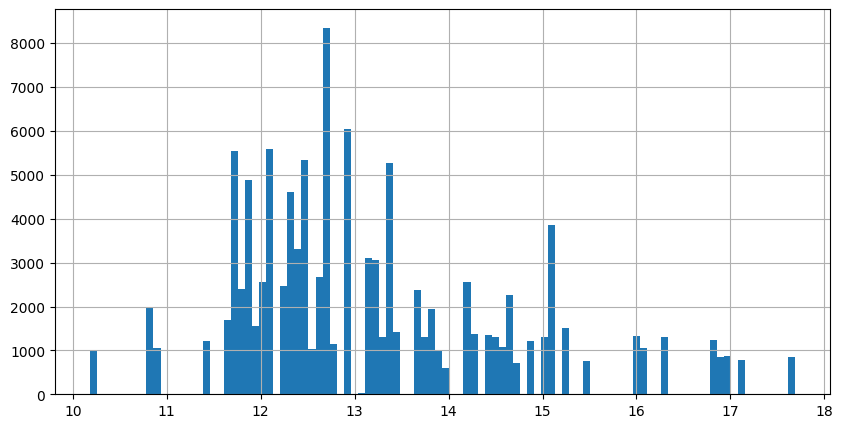

In [190]:
hex_france_with_grid_temp["TMoy (°C)"].hist(bins=100, figsize=(10, 5))

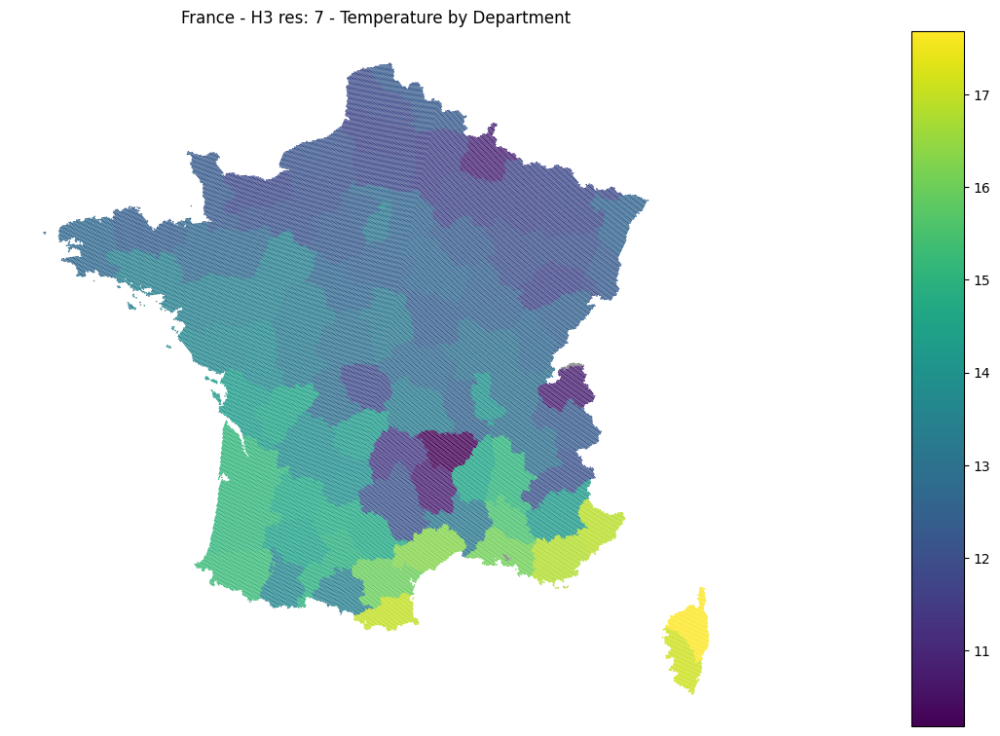

In [191]:
fig, ax1 = plt.subplots(1, 1, figsize=(12, 12))

divider1 = make_axes_locatable(ax1)
cax1 = divider1.append_axes("right", size="5%", pad=0.1)

hex_france_with_grid_temp.plot(
    "TMoy (°C)",
    legend=True,
    missing_kwds={"color": "grey"},
    ax=ax1,
    cax=cax1,
)
ax1.set_title("France - H3 res: 7 - Temperature by Department")
ax1.set_axis_off()

plt.tight_layout()

In [196]:
hex_france_with_grid_temp["TMoy (°C)_norm"] = min_max_scale(
    hex_france_with_grid_temp["TMoy (°C)"] * -1
)

In [197]:
### SAVE DATA TO START CONNECTING

In [198]:
(
    hex_france_with_grid_temp.rename(
        columns={
            "hex": "hexagon_id",
            "TMoy (°C)": "avg_temperature",
            "TMoy (°C)_norm": "normalized_score",
        }
    )
    .drop(columns=["geometry"])[["hexagon_id", "avg_temperature", "normalized_score"]]
    .to_csv("data_processed/hex_france_with_temp.csv", index=False)
)

In [ ]:
### END SAVE DATA

### Merging the network layer

Data source: Speedtest Global Index - Ookla Open Data

In [ ]:
network_speed = gpd.read_file(
    "data_pre_process/2024-10-01_performance_mobile_tiles.zip",
    bbox=tuple(hex_france_with_grid_temp.total_bounds.tolist()),
)

In [205]:
network_speed.shape

(171089, 7)

In [206]:
network_speed.head()

,quadkey,avg_d_kbps,avg_u_kbps,avg_lat_ms,tests,devices,geometry
0,0313130231220312,17239,2498,32,1,1,"POLYGON ((-4.53735 50.99647, -4.53186 50.99647..."
1,0313130231221113,32806,1455,32,3,1,"POLYGON ((-4.48792 51.0103, -4.48242 51.0103, ..."
2,0313130231221331,21599,6472,49,3,3,"POLYGON ((-4.48792 50.99301, -4.48242 50.99301..."
3,0313130231230220,44315,3862,47,2,2,"POLYGON ((-4.48242 50.99301, -4.47693 50.99301..."
4,0313130231230221,41353,14979,39,2,1,"POLYGON ((-4.47693 50.99301, -4.47144 50.99301..."


<Axes: >

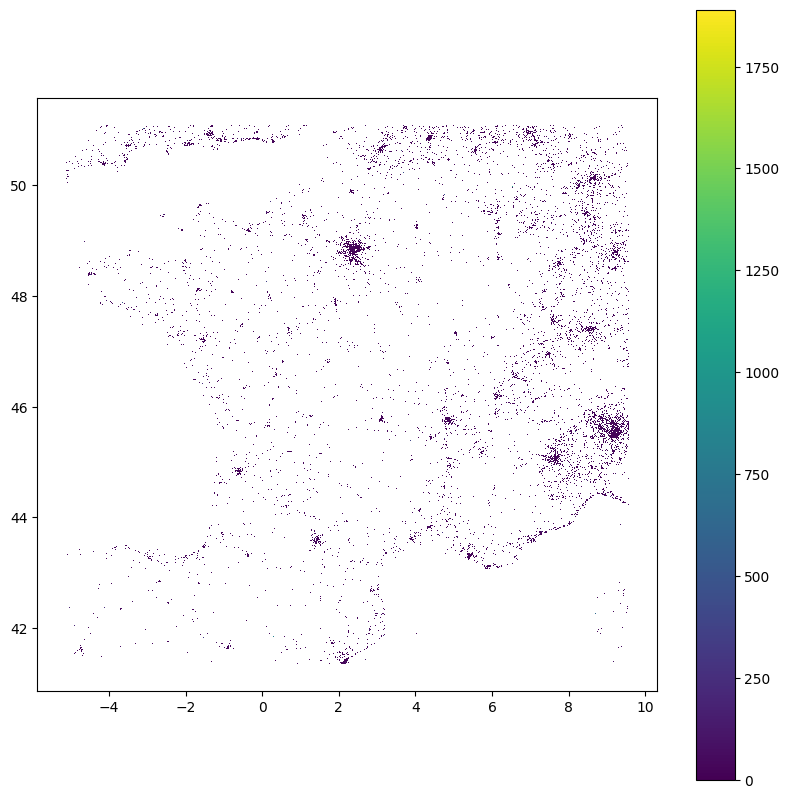

In [207]:
network_speed.plot("avg_lat_ms", legend=True, figsize=(10, 10))

In [212]:
from osmnx import project_gdf

In [210]:
network_speed.crs.to_string()

'EPSG:4326'

In [213]:
network_speed_proj = project_gdf(network_speed)

In [ ]:
avg_area_m2 = network_speed_proj.geometry.area.mean()
avg_area_km2 = avg_area_m2 / 1_000_000

print(f"Average area in m²: {avg_area_m2:.2f}")
print(f"Average area in km²: {avg_area_km2:.2f}")

Average area in m²: 171957.56
Average area in km²: 0.17


In [219]:
network_speed_centroids = network_speed.copy()
network_speed_centroids["geometry"] = network_speed_centroids.geometry.centroid

<Axes: >

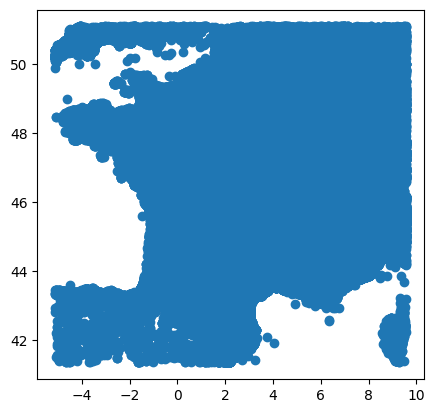

In [ ]:
network_speed_centroids.plot()

In [222]:
network_speed_centroids.head()

,quadkey,avg_d_kbps,avg_u_kbps,avg_lat_ms,tests,devices,geometry
0,0313130231220312,17239,2498,32,1,1,POINT (-4.53461 50.99474)
1,0313130231221113,32806,1455,32,3,1,POINT (-4.48517 51.00857)
2,0313130231221331,21599,6472,49,3,3,POINT (-4.48517 50.99129)
3,0313130231230220,44315,3862,47,2,2,POINT (-4.47968 50.99129)
4,0313130231230221,41353,14979,39,2,1,POINT (-4.47418 50.99129)


In [223]:
hex_france_with_grid_temp_net = up.geom.merge_shape_hex(
    hex_france_with_grid_temp, network_speed_centroids, agg={"avg_lat_ms": "mean"}
).rename(columns={"avg_lat_ms": "latency_ms"})

<Axes: >

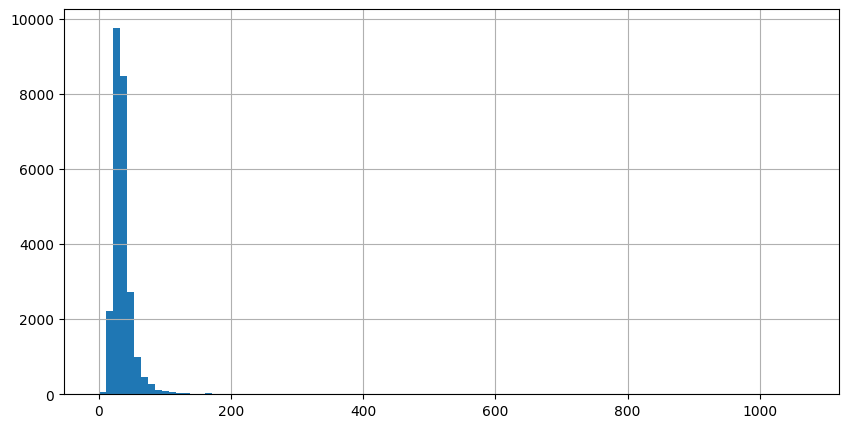

In [225]:
hex_france_with_grid_temp_net["latency_ms"].hist(bins=100, figsize=(10, 5))

In [232]:
hex_france_with_grid_temp_net["latency_ms"].describe()

count    25541.000000
mean        37.070487
std         29.198579
min          0.000000
25%         26.454545
50%         32.250000
75%         40.000000
max       1066.000000
Name: latency_ms, dtype: float64

NOTE: we cap at 100ms bc is already too bad for a data center

In [ ]:
hex_france_with_grid_temp_net["latency_ms"] = hex_france_with_grid_temp_net[
    "latency_ms"
].clip(upper=100)

In [234]:
print(
    f"Number of missing net connections: {hex_france_with_grid_temp_net['latency_ms'].isna().sum()}"
)
print(
    f"Percentage of missing net connections: {hex_france_with_grid_temp_net['latency_ms'].isna().sum() / hex_france_with_grid_temp_net.shape[0] * 100:.2f}%"
)

Number of missing net connections: 87907
Percentage of missing net connections: 77.49%


In [235]:
hex_france_with_grid_temp_net["latency_ms_norm"] = min_max_scale(
    hex_france_with_grid_temp_net["latency_ms"] * -1
)

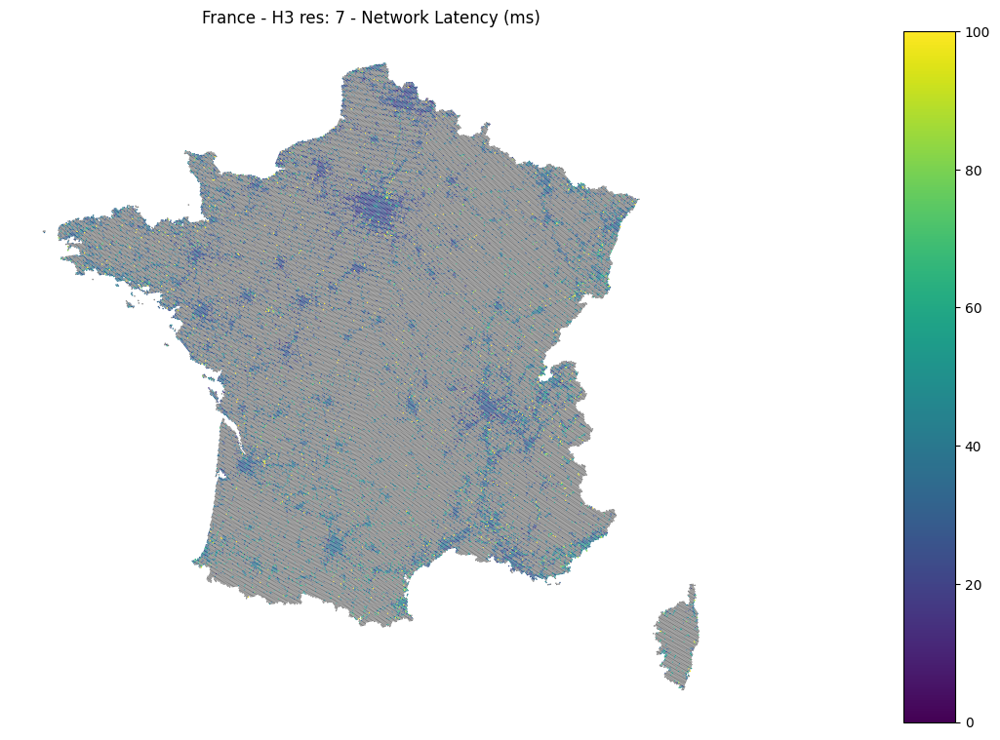

In [236]:
fig, ax1 = plt.subplots(1, 1, figsize=(12, 12))

divider1 = make_axes_locatable(ax1)
cax1 = divider1.append_axes("right", size="5%", pad=0.1)

hex_france_with_grid_temp_net.plot(
    "latency_ms",
    legend=True,
    missing_kwds={"color": "grey"},
    ax=ax1,
    cax=cax1,
)
ax1.set_title("France - H3 res: 7 - Network Latency (ms)")
ax1.set_axis_off()

plt.tight_layout()

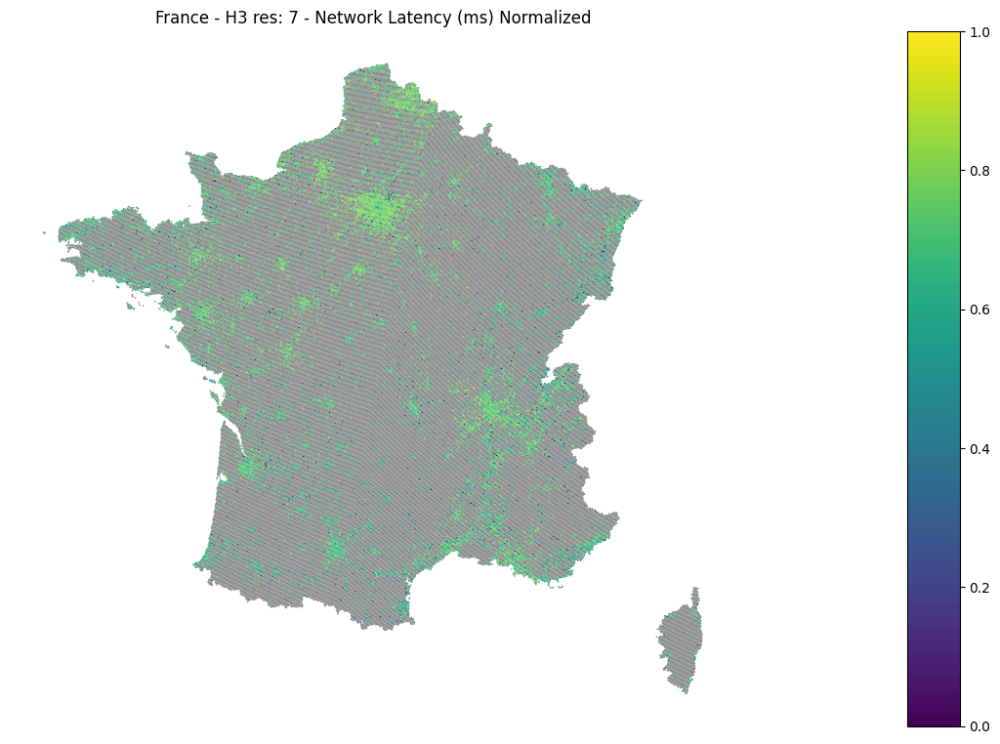

In [237]:
fig, ax1 = plt.subplots(1, 1, figsize=(12, 12))

divider1 = make_axes_locatable(ax1)
cax1 = divider1.append_axes("right", size="5%", pad=0.1)

hex_france_with_grid_temp_net.plot(
    "latency_ms_norm",
    legend=True,
    missing_kwds={"color": "grey"},
    ax=ax1,
    cax=cax1,
)
ax1.set_title("France - H3 res: 7 - Network Latency (ms) Normalized")
ax1.set_axis_off()

plt.tight_layout()

In [239]:
### SAVE DATA TO START CONNECTING

In [240]:
hex_france_with_grid_temp_net.head()

,hex,geometry,nb_grid_connections,nb_grid_connections_norm,index__dept,TMoy (°C),clean_names,TMoy (°C)_norm,latency_ms,latency_ms_norm
0,871eb0a14ffffff,"POLYGON ((9.45349 42.9889, 9.45484 42.97618, 9...",NaN,NaN,70.0,17.683302,haute-corse,0.000000,NaN,NaN
1,871eb2211ffffff,"POLYGON ((9.01 41.57103, 9.01139 41.55817, 9.0...",NaN,NaN,36.0,17.125909,corse-du-sud,0.074317,NaN,NaN
2,871eb0693ffffff,"POLYGON ((9.14919 42.10934, 9.15057 42.09653, ...",NaN,NaN,70.0,17.683302,haute-corse,0.000000,NaN,NaN
3,871eb2398ffffff,"POLYGON ((8.84767 41.53586, 8.84908 41.52301, ...",NaN,NaN,36.0,17.125909,corse-du-sud,0.074317,NaN,NaN
4,871eb07b6ffffff,"POLYGON ((8.96041 42.30443, 8.96181 42.29166, ...",NaN,NaN,70.0,17.683302,haute-corse,0.000000,NaN,NaN


In [241]:
(
    hex_france_with_grid_temp_net.rename(
        columns={
            "hex": "hexagon_id",
            "latency_ms_norm": "normalized_score",
        }
    )
    .drop(columns=["geometry"])[["hexagon_id", "latency_ms", "normalized_score"]]
    .to_csv("data_processed/hex_france_with_network.csv", index=False)
)

In [ ]:
### END SAVE DATA

In [243]:
hex_france_with_grid_temp_net.columns

Index(['hex', 'geometry', 'nb_grid_connections', 'nb_grid_connections_norm',
       'index__dept', 'TMoy (°C)', 'clean_names', 'TMoy (°C)_norm',
       'latency_ms', 'latency_ms_norm'],
      dtype='object')

In [ ]:
hex_france_with_grid_temp_net.to_parquet(
    "data_processed/hex_france_with_network.parquet"
)

In [ ]:
(
    hex_france_with_grid_temp_net.rename(
        columns={
            "hex": "hexagon_id",
            "clean_names": "department_name",
            "nb_grid_connections": "connection_points",
            "nb_grid_connections_norm": "normalized_score",
            "TMoy (°C)": "mean_temperature",
            "TMoy (°C)_norm": "normalized_mean_temperature",
            "latency_ms": "latency_ms",
            "latency_ms_norm": "normalized_latency_ms",
        }
    )
    .drop(columns=["geometry"])[
        [
            "hexagon_id",
            "department_name",
            "connection_points",
            "normalized_score",
            "mean_temperature",
            "normalized_mean_temperature",
            "latency_ms",
            "normalized_latency_ms",
        ]
    ]
    .to_parquet("data_processed/hex_france_complete.parquet", index=False)
)

## Calculate trip distance and duration from each hexagon to the closest food facility

We will use the `overpass_pois` function to function to get the points of interest (POIs) from OpenStreetMap (OSM). We will define three arguments:

- the `type_of_data` to get from OSM (`node`, `way`, `relation`)
- a `mask` that represent the area where to get the data
- a `query` dictionary with the OSM tags to filter the POIs

In [ ]:
# fs, metadata = up.download.overpass(
#     type_of_data="node",
#     mask=lima,
#     query={
#         "amenity": ["marketplace"],
#         "shop": [
#             "supermarket",
#             "kiosk",
#             "mall",
#             "convenience",
#             "butcher",
#             "greengrocer",
#         ],
#     },
# )

Read more about posible OSM tags to use [here](https://wiki.openstreetmap.org/wiki/Map_features).

In [35]:
fs.shape

(2437, 7)

<Axes: >

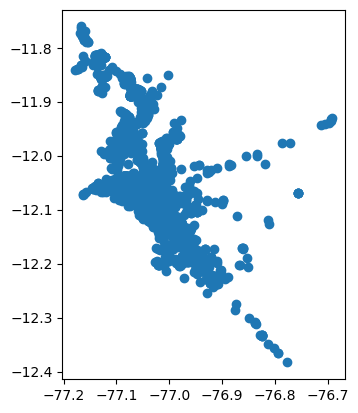

In [36]:
fs.plot()

Use OSRM routing server to find walking distance and duration 

In [37]:
# start server
up.routing.start_osrm_server("peru", "south-america", "foot")

Server is already running.


Neighborhood search to find closest food facility

> HINT: If you get a "IProgress not found." error when running the cell below, install it with: `pip install ipywidgets`

In [38]:
# Uncomment line below to install ipywidgets.
# %pip install ipywidgets

In [39]:
hex_lima_access = up.accessibility.travel_times(hex_lima, fs, "food_facility")

  0%|          | 0/3284 [00:00<?, ?it/s]

In [40]:
hex_lima_access.head()

,hex,geometry,per_general_2020,lon,lat,nearest_food_facility_ix,distance_to_nearest_food_facility,duration_to_nearest_food_facility,duration_to_nearest_food_facility_label
0,888e6211c1fffff,"POLYGON ((-76.82145 -12.25126, -76.82576 -12.2...",58.199386,-76.820939,-12.256447,17,6.8118,81.731667,60-90
1,888e6289a9fffff,"POLYGON ((-76.82604 -12.11022, -76.83035 -12.1...",1758.489417,-76.825529,-12.115409,365,1.7662,21.191667,15-30
2,888e628d83fffff,"POLYGON ((-76.66382 -12.21195, -76.66813 -12.2...",NaN,-76.663308,-12.217140,304,47.1192,565.446667,> 120
3,888e66690dfffff,"POLYGON ((-77.11147 -11.68996, -77.11578 -11.6...",NaN,-77.110964,-11.695157,2436,8.0203,96.248333,90-120
4,888e628a91fffff,"POLYGON ((-76.69740 -12.05812, -76.70171 -12.0...",NaN,-76.696888,-12.063308,815,7.9916,95.905000,90-120


In [41]:
up.routing.stop_osrm_server("peru", "south-america", "foot")

Server was stoped succesfully


## Generate interactive maps

In [42]:
plotly.offline.init_notebook_mode()

> HINT: If you get a "nbformat not found" error when running the cell below, install with: `pip install nbformat`

In [43]:
# Uncomment line below to install nbformat.
# %pip install nbformat

In [44]:
fig = up.plotting.choropleth_map(
    hex_lima,
    "per_general_2020",
    title="Estimated Population - 2020",
    width=400,
    height=400,
)

# Make space for the title
fig.update_layout(margin=dict(l=0, r=0, b=0))

fig.show()

You can customize your plot usign the plotly.express.choropletmap function parameters

In [45]:
# Get ordered category labels
category_orders = (
    hex_lima_access["duration_to_nearest_food_facility_label"].unique().sort_values()
)
category_orders.categories

Index(['0-15', '15-30', '30-45', '45-60', '60-90', '90-120', '> 120'], dtype='object')

In [46]:
# Filter out the hexagons without population
hex_lima_access_filtered_pop = hex_lima_access.query(
    "per_general_2020 > 0"
).reset_index(drop=True)

In [47]:
fig = up.plotting.choropleth_map(
    hex_lima_access_filtered_pop,
    color_column="duration_to_nearest_food_facility_label",
    color_discrete_sequence=px.colors.sequential.Plasma_r,
    category_orders={"duration_to_nearest_food_facility_label": category_orders},
    labels={"duration_to_nearest_food_facility_label": "Minutes"},
    title="Travel Time to Nearest Food Facility",
    width=400,
    height=400,
)

# Make space for the title
fig.update_layout(margin=dict(l=0, r=0, b=0))

# Remove the hexagon outlines to make the map clearer
fig.update_traces(marker_line_width=0)

fig.show()